In [1]:
import os
import cv2 as cv
import random


from config import Config
from Custom_layers import *
from resources import utils
from coco import CocoConfig
from resources import visualize
from model import MaskRCNN
os.environ['CUDA_VISIBLE_DEVICES'] = '-1'

In [2]:
class InferenceConfig(CocoConfig):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    BATCH_SIZE = 1
    DETECTION_MIN_CONFIDENCE = 0.75


config = InferenceConfig()

In [3]:
LOG_PATH = "./logs"
IMAGE_DIR = "../images"
if not os.path.exists(LOG_PATH):
    os.system('mkdir logs')

if not os.path.exists(os.path.join(LOG_PATH, 'mask_rcnn_coco.5')):
    utils.download_trained_weights(os.path.join(LOG_PATH, 'mask_rcnn_coco.5'))

In [4]:
mrcnn = MaskRCNN('inference', config, './models')
mrcnn.load_weights(os.path.join(LOG_PATH, 'mask_rcnn_coco.5'), by_name=True)

class_names = ['BG', 'person', 'bicycle', 'car', 'motorcycle', 'airplane',
               'bus', 'train', 'truck', 'boat', 'traffic light',
               'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird',
               'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear',
               'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie',
               'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
               'kite', 'baseball bat', 'baseball glove', 'skateboard',
               'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup',
               'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
               'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
               'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed',
               'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote',
               'keyboard', 'cell phone', 'microwave', 'oven', 'toaster',
               'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors',
               'teddy bear', 'hair drier', 'toothbrush']

Instructions for updating:
Use fn_output_signature instead


2022-08-01 13:55:28.981744: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-08-01 13:55:28.981793: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:169] retrieving CUDA diagnostic information for host: pop-os
2022-08-01 13:55:28.981800: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:176] hostname: pop-os
2022-08-01 13:55:28.981970: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:200] libcuda reported version is: 515.48.7
2022-08-01 13:55:28.981998: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:204] kernel reported version is: 515.48.7
2022-08-01 13:55:28.982004: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:310] kernel version seems to match DSO: 515.48.7
2022-08-01 13:55:29.411185: W tensorflow/core/util/tensor_slice_reader.cc:96] Could not open ./logs/mask_rcnn_coco.5: DATA_LOSS: not an sstable (bad magic number): perhaps your file is in a different file format

In [5]:
images = []
for filename in os.listdir(IMAGE_DIR):
    image = cv.imread(os.path.join(IMAGE_DIR, filename))
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    images.append(image)
len(images)

29

/home/renmichel/anaconda3/lib/python3.9/site-packages/keras/engine/training_v1.py:2067: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,
2022-08-01 13:55:46.494380: W tensorflow/core/grappler/costs/op_level_cost_estimator.cc:690] Error in PredictCost() for the op: op: "CropAndResize" attr { key: "T" value { type: DT_FLOAT } } attr { key: "extrapolation_value" value { f: 0 } } attr { key: "method" value { s: "bilinear" } } inputs { dtype: DT_FLOAT shape { dim { size: -53 } dim { size: -313 } dim { size: -314 } dim { size: 256 } } } inputs { dtype: DT_FLOAT shape { dim { size: -19 } dim { size: 4 } } } inputs { dtype: DT_INT32 shape { dim { size: -19 } } } inputs { dtype: DT_INT32 shape { dim { size: 2 } } value { dtype: DT_INT32 tensor_shape { dim { size: 2 } } int_val: 7 } } device { type: "CPU" vendor: "GenuineIntel" model: "110" frequency: 2

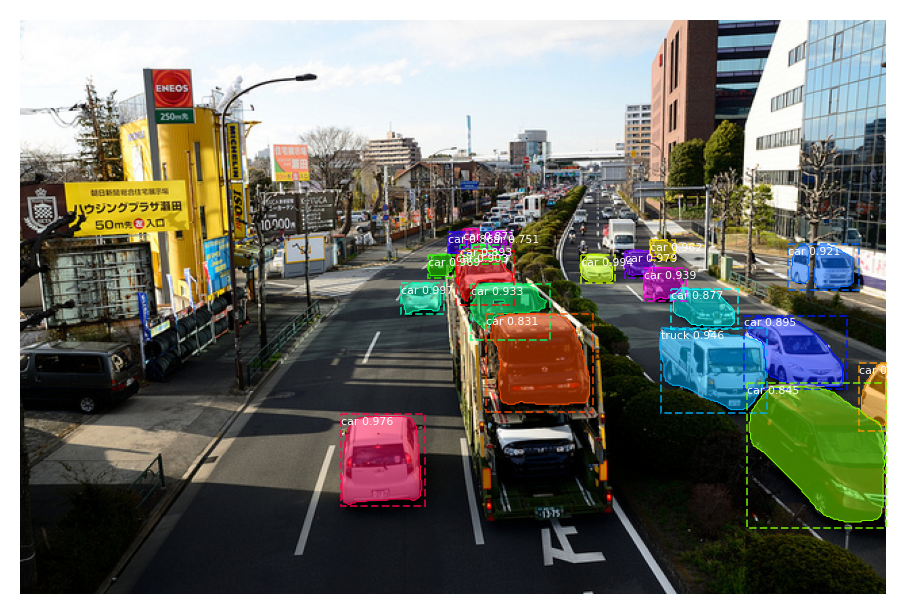

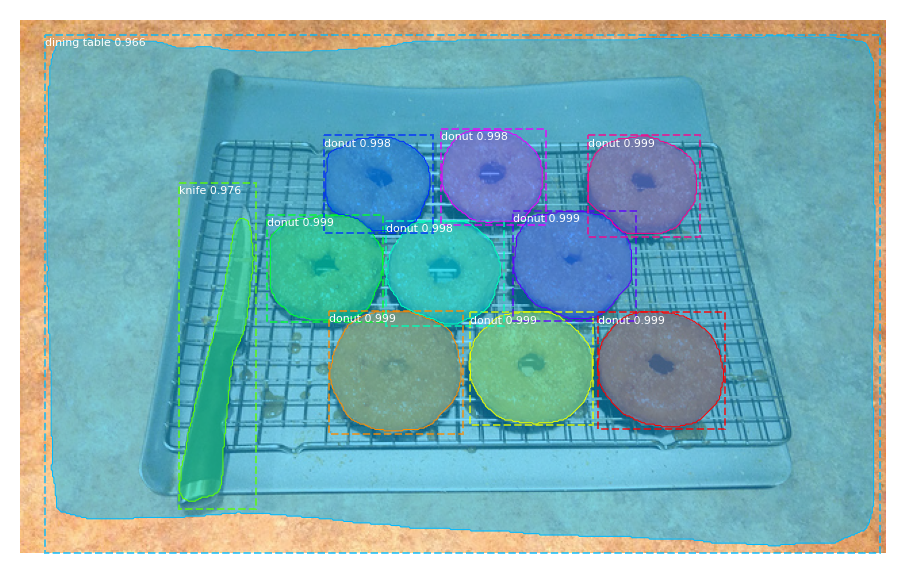

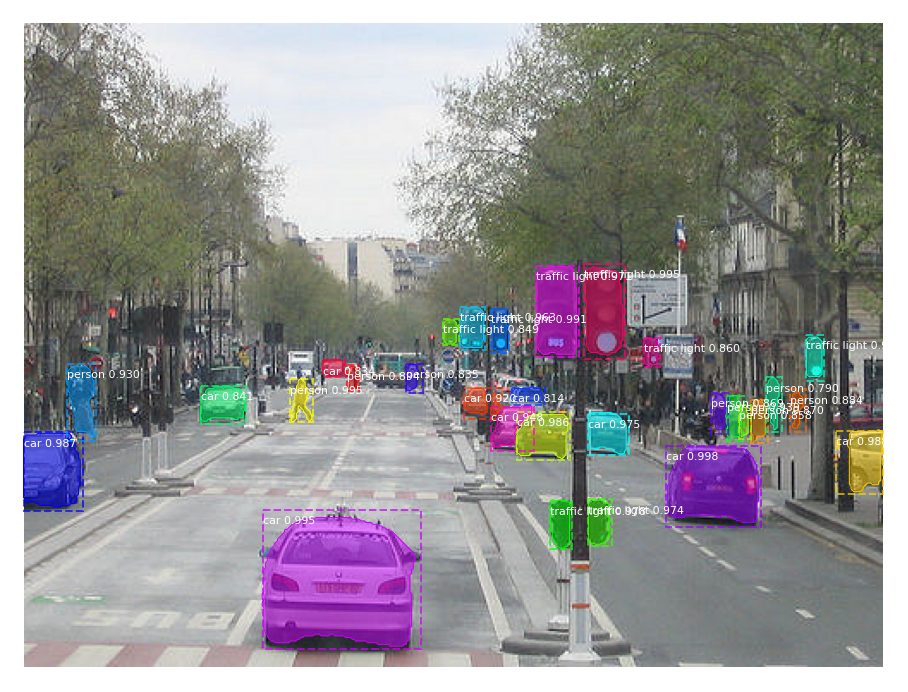

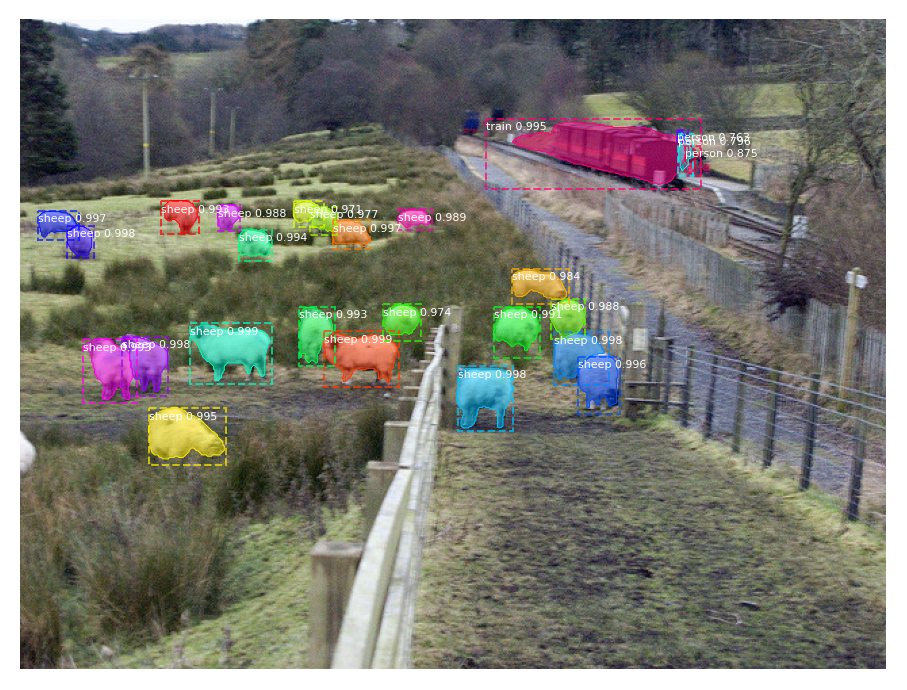

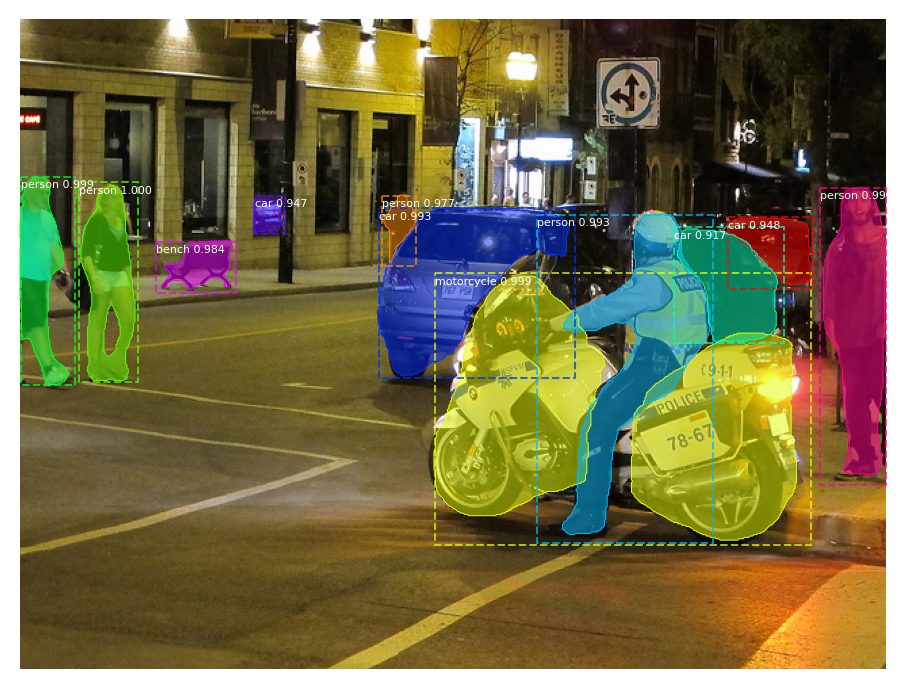

...

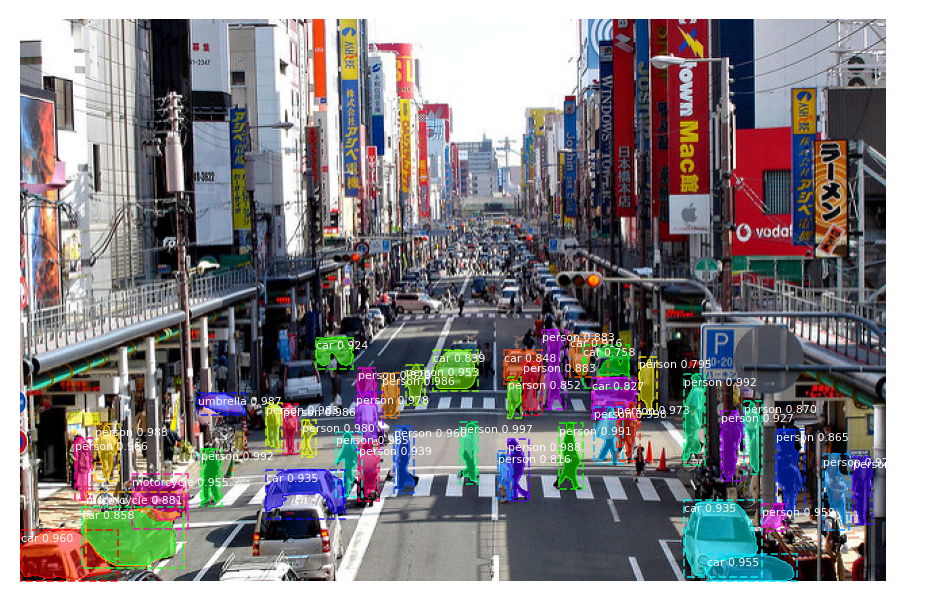

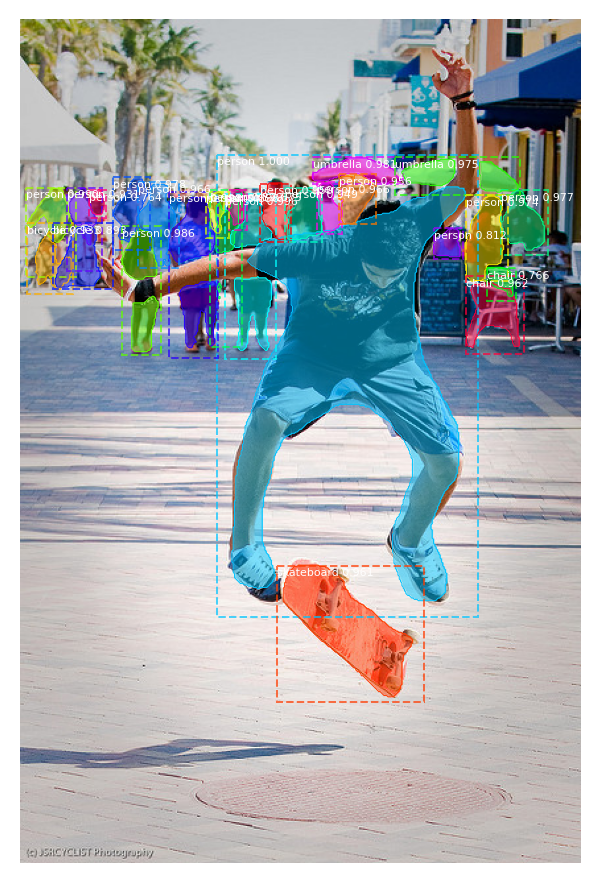

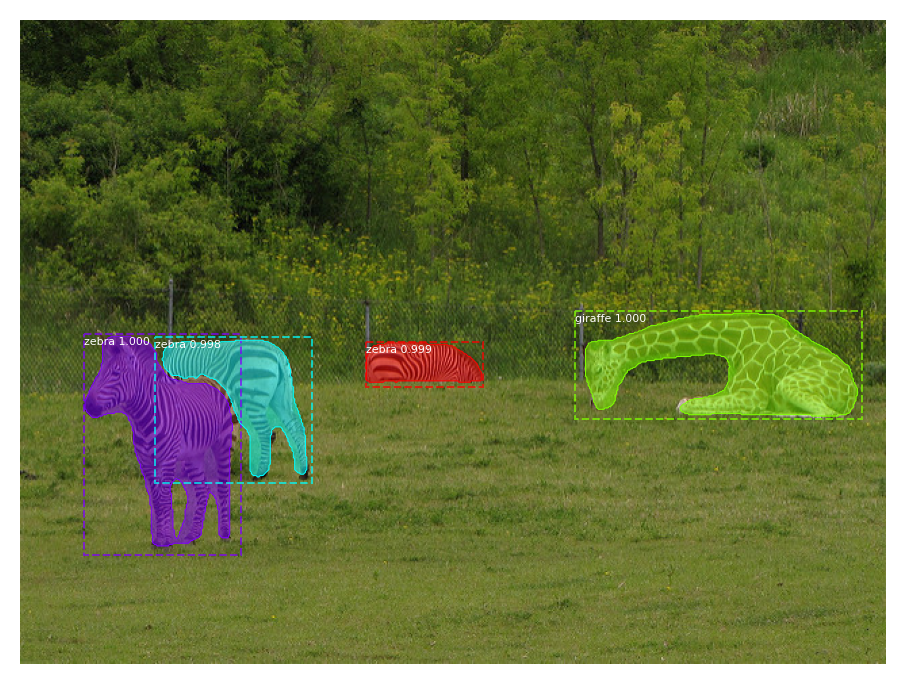

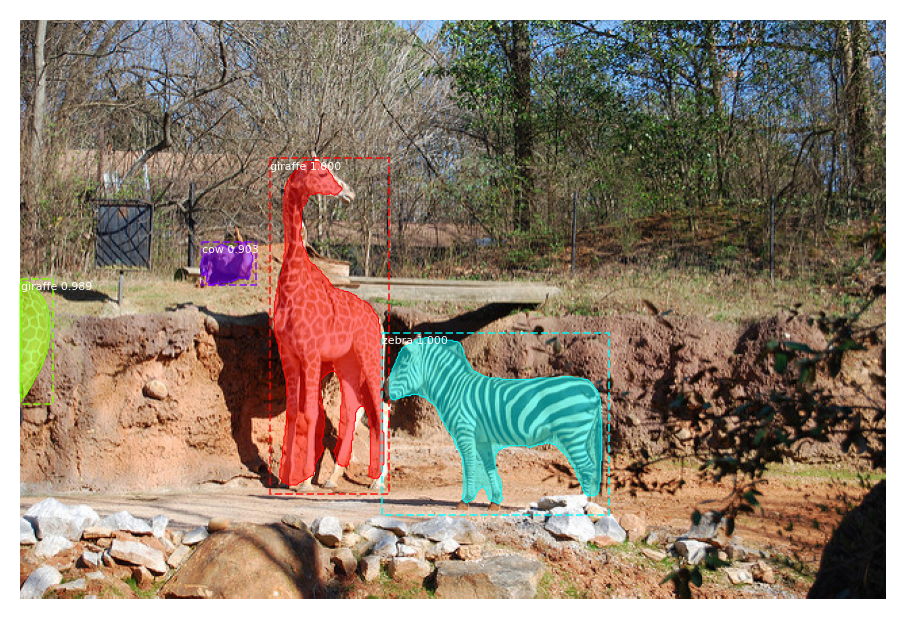

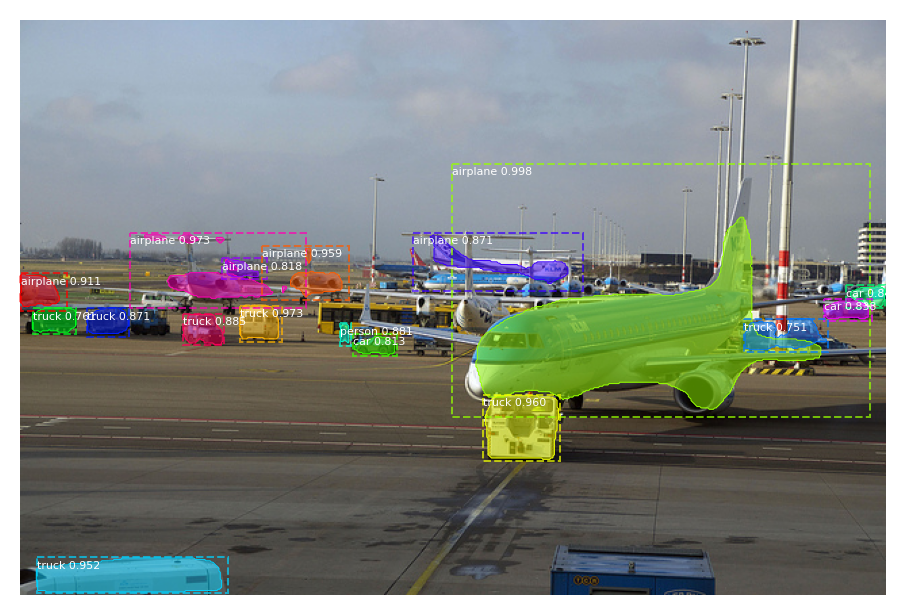

In [6]:
for img in images:
    results = mrcnn.detect([img], verbose=0)
    r = results[0]

    visualize.display_instances(img, r['rois'], r['masks'], r['class_ids'],
                                class_names, r['scores'])